In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm import tqdm
import skimage.color as sColor
import skimage.io as io
from skimage.feature import hog
import skimage.transform as trs
from sklearn.manifold import TSNE 
from sklearn.decomposition import PCA 


In [3]:
images = io.imread_collection('../annunciation\*.jpg' )
images2 = io.imread_collection('../cropped18/*.jpg')

In [4]:
images1 = np.concatenate((images,images2),axis=0)

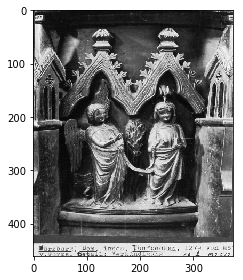

In [7]:
io.imshow(images1[])

In [8]:
squaredImg = []
for image in tqdm(images1):
    squaredImg.append(trs.resize(image, (256,256)))

100%|████████████████████████████████████████| 587/587 [00:16<00:00, 34.97it/s]


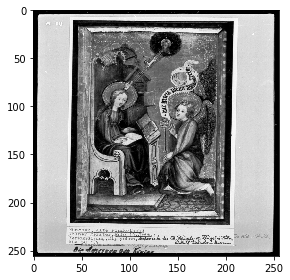

In [6]:
io.imshow(squaredImg[120])

In [9]:
sColor.rgb2gray(squaredImg[0]).shape

(256, 256)

In [10]:
hogImg = [] 
for img in tqdm(squaredImg) : 
    tmp, hogIm  =hog(sColor.rgb2grey(img), orientations = 8,pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1),visualise = True, transform_sqrt = True)
    hogImg.append(hogIm)

100%|████████████████████████████████████████| 587/587 [00:36<00:00, 16.05it/s]


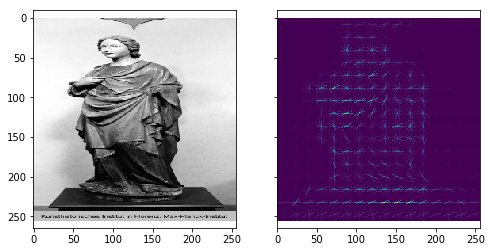

In [11]:

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)
ax1.imshow(squaredImg[80],cmap ='gray' )
ax2.imshow(hogImg[80])


In [8]:
flattened = []
for img in hogImg :
    flattened.append(img.flatten())
np.asarray(flattened).shape


(587, 65536)

In [9]:
hog_pca = PCA(n_components=50).fit_transform(flattened)
hog_embedded = TSNE(n_components=2).fit_transform(hog_pca)
hog_embedded.shape

(587, 2)

In [10]:
from matplotlib.offsetbox import AnnotationBbox,OffsetImage
fig = plt.figure(figsize=(170, 170))
plt.scatter(hog_embedded[:, 0], hog_embedded[:, 1], marker=None)

ax = plt.subplot(111)
for i in range(len(squaredImg)) :
    im = OffsetImage(squaredImg[i], cmap = 'gray', zoom=0.70)
    im.image.axis =ax
    ab =AnnotationBbox(im,[hog_embedded[i,0],hog_embedded[i,1]],frameon=False) 
    ax.add_artist(ab)

plt.show()
fig.savefig("newPlt.png")